<a href="https://colab.research.google.com/github/ncheungg/road-lane-detection/blob/master/Road_Lane_Detection.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
import cv2
import numpy as np
from matplotlib import pyplot as plt
import matplotlib.animation as animation
import urllib
from matplotlib import rc

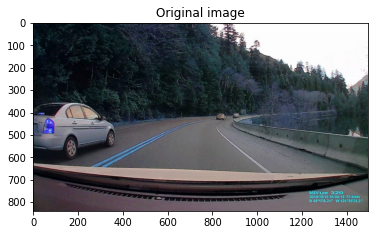

In [2]:
##### fetch dashcam image
def fetch_image():
  image_url = "https://raw.githubusercontent.com/ncheungg/road-lane-detection/master/assets/dashcam.png"
  url_response = urllib.request.urlopen(image_url)
  img_array = np.array(bytearray(url_response.read()), dtype=np.uint8)
  return cv2.imdecode(img_array, -1)

image_original = fetch_image()

plt.imshow(image_original)
plt.title("Original image")
plt.show()

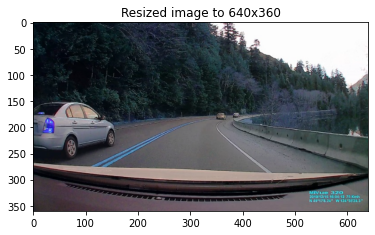

In [3]:
##### resize image to 640x360
def resize_image(image):
  return cv2.resize(image, (640, 360))
  
image_resized = resize_image(image_original)

plt.imshow(image_resized)
plt.title("Resized image to 640x360")
plt.show()

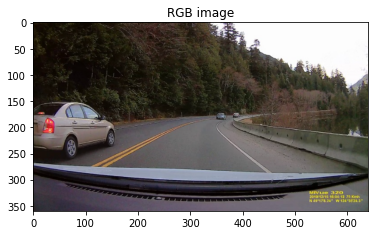

In [4]:
##### convert image to RGB
def convert_image_to_rgb(image):
  return cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
  
image_rgb = convert_image_to_rgb(image_resized)

plt.imshow(image_rgb)
plt.title("RGB image")
plt.show()

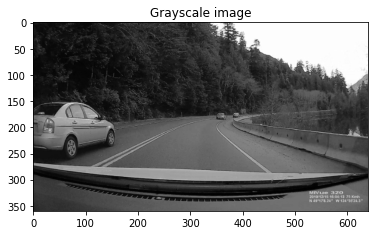

In [5]:
##### convert to grayscale image
def convert_image_to_gray(image):
  return cv2.cvtColor(image, cv2.COLOR_RGB2GRAY)

image_gray = convert_image_to_gray(image_rgb)

plt.imshow(image_gray, cmap='gray', vmin = 0, vmax = 255)
plt.title("Grayscale image")
plt.show()

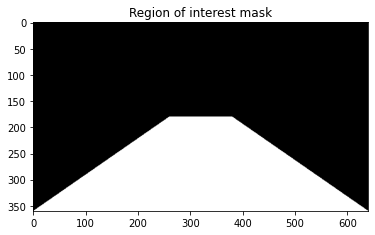

In [6]:
##### define a region of interest for a 640x360 image
def create_region_of_interest(image):
  p1 = 0, 360
  p2 = 640, 360
  p3 = 380, 180
  p4 = 260, 180

  points = np.array([p1, p2, p3, p4])
  mask = np.zeros_like(image)
  cv2.fillPoly(mask, pts=[points], color=255)
  return mask

region_of_interest = create_region_of_interest(image_gray)

plt.imshow(region_of_interest, cmap='gray', vmin = 0, vmax = 255)
plt.title("Region of interest mask")
plt.show()

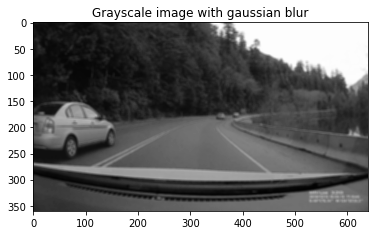

In [7]:
##### add gaussian blur
def add_gaussian_blur(image):
  return cv2.GaussianBlur(image, (5, 5), 10)

image_blur = add_gaussian_blur(image_gray)

plt.imshow(image_blur, cmap='gray', vmin = 0, vmax = 255)
plt.title("Grayscale image with gaussian blur")
plt.show()

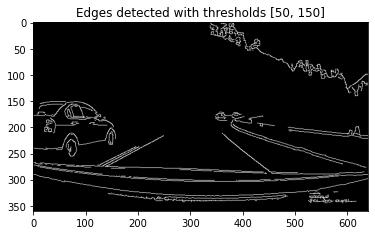

In [8]:
##### find edges using canny edge detector
def get_edges(image):
  return cv2.Canny(image, 50, 150)

image_edges = get_edges(image_blur)

plt.imshow(image_edges, cmap='gray', vmin = 0, vmax = 255)
plt.title("Edges detected with thresholds [50, 150]")
plt.show()

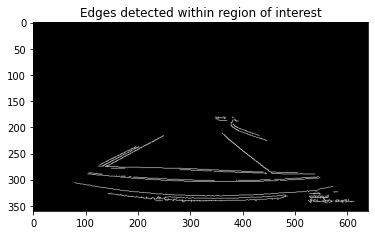

In [9]:
##### find edges in region of interest
def get_interesting_edges(image, mask):
  return cv2.bitwise_and(image, mask)

image_edges_region = get_interesting_edges(image_edges, region_of_interest)

plt.imshow(image_edges_region, cmap='gray', vmin = 0, vmax = 255)
plt.title("Edges detected within region of interest")
plt.show()

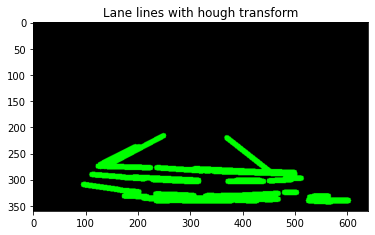

In [10]:
##### find lines using hough transform
def get_hough_lines(image):
  result = cv2.HoughLinesP(image, 2, np.pi/180, 75, np.array([]),
                         minLineLength=20, maxLineGap=15)
  return np.array([]) if result is None else result

lane_lines = get_hough_lines(image_edges_region)
image_lines = np.zeros_like(image_rgb)

# display our lines
for line in lane_lines:
  x1, y1, x2, y2 = line.reshape(4)
  cv2.line(image_lines, (x1, y1), (x2, y2), color=(0, 255, 0), thickness=10)

plt.imshow(image_lines)
plt.title("Lane lines with hough transform")
plt.show()

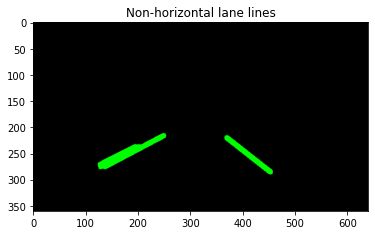

In [11]:
##### remove nearly horizontal lines

# function returns True if not nearly horizontal (+- 10 degrees)
def is_not_nearly_horizontal(line):
  x1, y1, x2, y2 = line.reshape(4)
  angle = np.arctan2(y2 - y1, x2 - x1) * 180 / np.pi
  return abs(angle) >= 10

def get_non_horizontal_lines(lines):
  return list(filter(is_not_nearly_horizontal, lines))

lane_lines_not_horizontal = get_non_horizontal_lines(lane_lines)
image_lines_non_horizontal = np.zeros_like(image_rgb)

# display our lines
for line in lane_lines_not_horizontal:
  x1, y1, x2, y2 = line.reshape(4)
  cv2.line(image_lines_non_horizontal, (x1, y1), (x2, y2), color=(0, 255, 0), thickness=10)

plt.imshow(image_lines_non_horizontal)
plt.title("Non-horizontal lane lines")
plt.show()

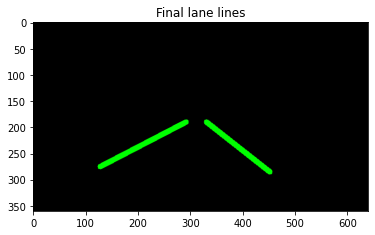

In [12]:
##### get left and right lane lines

# makes the final lane line given slope and low/high points of y values
def make_line(params, lowest, highest):
  m, b = params

  y1, y2 = lowest, highest
  x1 = int((y1 - b) / m)
  x2 = int((y2 - b) / m)
  return np.array([x1, y1, x2, y2])

def average_out_line(lines):
  if len(lines) == 0:
    return None

  line_params = []
  max_y = 0

  for line in lines:
    x1, y1, x2, y2 = line.reshape(4)
    m, b = np.polyfit((x1, x2), (y1, y2), 1)

    line_params.append((m, b))
    max_y = max(max_y, y1, y2)

  avg_params = np.average(line_params, axis=0)

  return make_line(avg_params, max_y, 190)

def get_left_and_right_lane_lines(lines):
  left_lines = []
  right_lines = []

  for line in lines:
    x1, y1, x2, y2 = line.reshape(4)
    m, b = np.polyfit((x1, x2), (y1, y2), 1)

    # positive slope is left line, negative slope is right line
    if m < 0:
      left_lines.append(line)
    else:
      right_lines.append(line)

  left_line = average_out_line(left_lines)
  right_line = average_out_line(right_lines)

  return left_line, right_line

final_lane_lines = get_left_and_right_lane_lines(lane_lines_not_horizontal)
image_final_lane_lines = np.zeros_like(image_rgb)

# display our lines
for line in final_lane_lines:
  if line is None:
    continue
  
  x1, y1, x2, y2 = line.reshape(4)
  cv2.line(image_final_lane_lines, (x1, y1), (x2, y2), color=(0, 255, 0), thickness=10)

plt.imshow(image_final_lane_lines)
plt.title("Final lane lines")
plt.show()

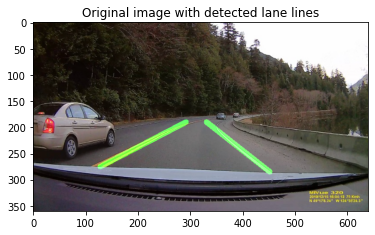

In [13]:
##### display input image with lane lines
def get_final_image(original_image, final_lane_lines):
  image_final_lane_lines = np.zeros_like(original_image)

  for line in final_lane_lines:
    if line is None:
      continue
    
    x1, y1, x2, y2 = line.reshape(4)
    cv2.line(image_final_lane_lines, (x1, y1), (x2, y2), color=(0, 255, 0), thickness=10)

  return cv2.addWeighted(image_final_lane_lines, 0.8, original_image, 1, 1)

image_rgb_with_lines = get_final_image(image_rgb, final_lane_lines)

plt.imshow(image_rgb_with_lines)
plt.title("Original image with detected lane lines")
plt.show()

In [14]:
##### import dashcam videos
videos = [
  'https://github.com/ncheungg/road-lane-detection/raw/master/assets/video.hevc',
  'https://github.com/ncheungg/road-lane-detection/raw/master/assets/video2.hevc',
  'https://github.com/ncheungg/road-lane-detection/raw/master/assets/video3.hevc',
  'https://github.com/ncheungg/road-lane-detection/raw/master/assets/video4.hevc',
  'https://github.com/ncheungg/road-lane-detection/raw/master/assets/video5.hevc',
  'https://github.com/ncheungg/road-lane-detection/raw/master/assets/video6.hevc',
  'https://github.com/ncheungg/road-lane-detection/raw/master/assets/video7.hevc',
  'https://github.com/ncheungg/road-lane-detection/raw/master/assets/video8.hevc',
  'https://github.com/ncheungg/road-lane-detection/raw/master/assets/video9.hevc',
  'https://github.com/ncheungg/road-lane-detection/raw/master/assets/video10.hevc',
]

captures = lambda x: cv2.VideoCapture(videos[x])

In [15]:
##### CVRoadLaneDetector class that processes frames
##### it stores a sliding window of the last 10 frames

class CVRoadLaneDetector:
  def __init__(self, image):
    self.window = []
    self.region_of_interest = create_region_of_interest(image)

  def get_average_lane_lines_in_window(self):
    left_lines = []
    right_lines = []
    left_max = right_max = 0

    for left_line, right_line in self.window:
      if left_line is not None:
        left_lines.append(left_line)

      if right_line is not None:
        right_lines.append(right_line)

    left_line = average_out_line(left_lines)
    right_line = average_out_line(right_lines)

    return left_line, right_line

  # the main detection algorithm
  def compute_frame(self, frame):
    frame_resized = resize_image(frame)
    frame_rgb = convert_image_to_rgb(frame_resized)
    frame_gray = convert_image_to_gray(frame_rgb)

    frame_edges = get_edges(frame_gray)
    frame_edges_in_region = get_interesting_edges(frame_edges, self.region_of_interest)
    lane_lines = get_hough_lines(frame_edges_in_region)
    lane_lines_not_horizontal = get_non_horizontal_lines(lane_lines)

    # add current lane lines to sliding window of last 10 frames
    current_frame_lane_lines = get_left_and_right_lane_lines(lane_lines_not_horizontal)
    self.window = self.window[-9:] + [current_frame_lane_lines]

    # average the last 10 frame's lane lines
    final_lane_lines = self.get_average_lane_lines_in_window()

    final_image = get_final_image(frame_rgb, final_lane_lines)
    return final_image

In [16]:
##### functions that processes/displays videos in notebook
##### NOTE: these are very expensive functions, use with caution

rc('animation', html='jshtml')

def display_video_original_processed(cap):
  ims = []
  fig = plt.figure(figsize=(9, 12));
  ax1 = fig.add_subplot(2, 1, 1)
  ax2 = fig.add_subplot(2, 1, 2)
  ax1.title.set_text("Original video in RGB")
  ax2.title.set_text("Processed video with lane lines")

  # initializes CVRoadLaneDetector class
  detector = CVRoadLaneDetector(image_gray)
  
  while True:
    ret, frame = cap.read()
    
    if not ret: 
      break

    rgb_frame = convert_image_to_rgb(frame)
    processed_frame = detector.compute_frame(frame)

    im1 = ax1.imshow(rgb_frame)
    im2 = ax2.imshow(processed_frame)
    ims.append([im1, im2])
    
  return animation.ArtistAnimation(fig, ims, interval=50)

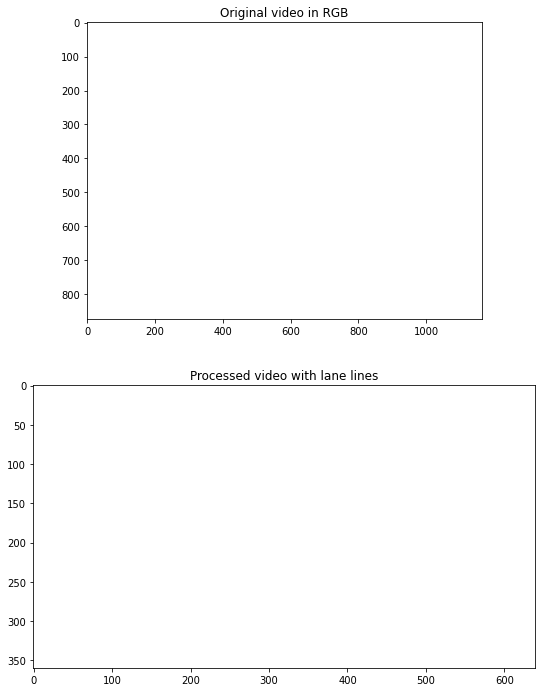

In [17]:
display_video_original_processed(captures(8))

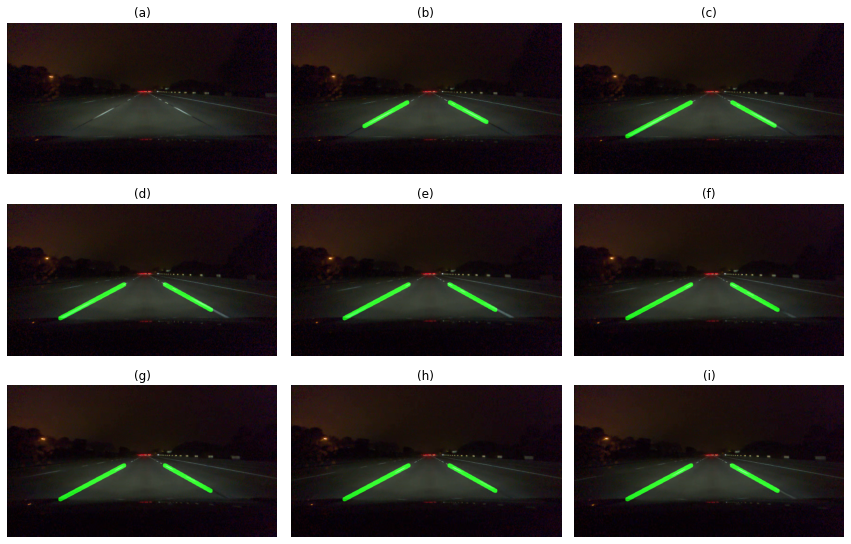

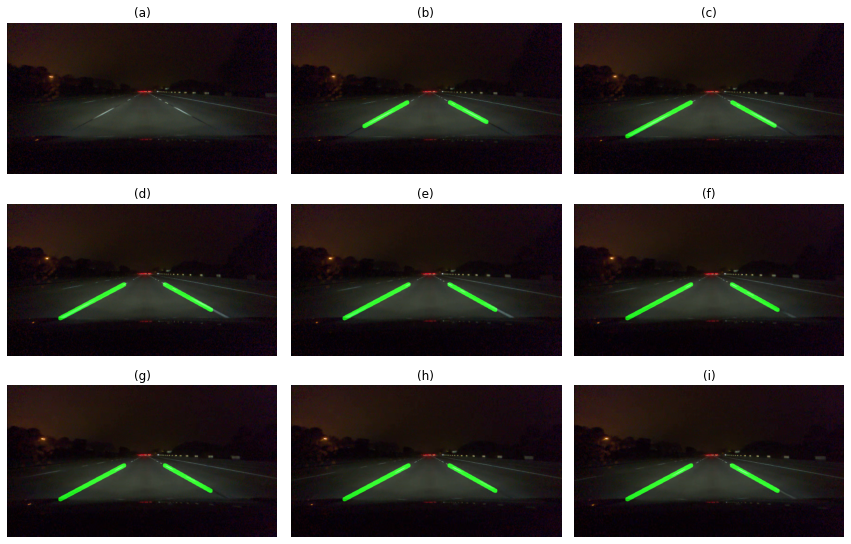

In [18]:
##### additional
##### generates subplot of first 9 video frames

detector = CVRoadLaneDetector(image_gray)
cap = captures(8)
fig, axs = plt.subplots(3, 3, figsize=(15,10), gridspec_kw=dict(wspace=0.05, hspace=0))


for i in range(3):
  for j in range(3):
    ret, frame = cap.read()

    rgb_frame = convert_image_to_rgb(frame)
    processed_frame = detector.compute_frame(frame)

    axs[i, j].imshow(processed_frame)
    axs[i, j].axis('off')

axs[0, 0].set_title('(a)')
axs[0, 1].set_title('(b)')
axs[0, 2].set_title('(c)')
axs[1, 0].set_title('(d)')
axs[1, 1].set_title('(e)')
axs[1, 2].set_title('(f)')
axs[2, 0].set_title('(g)')
axs[2, 1].set_title('(h)')
axs[2, 2].set_title('(i)')

fig